In [1]:
import numpy as np
from astropy.io import ascii
import matplotlib.pyplot as plt
import ast
from panoptes_client import Panoptes, Subject
from skimage import io
import getpass
%matplotlib inline

Broken libmagic installation detected. The python-magic module is installed but can't be imported. Please check that both python-magic and the libmagic shared library are installed correctly. Uploading media other than images may not work.


Enter your Panoptes (Zooniverse) account details so that we can fetch the subjects from the Panoptes client

In [2]:
username = getpass.getpass('Username:')
password = getpass.getpass('Password:')
Panoptes.connect(username=username, password=password)

Username:········
Password:········


Load the reduced data

In [4]:
points_file = 'point_reducer_hdbscan_box_the_jets.csv'
points_data = ascii.read(points_file, delimiter=',')

box_file = 'shape_reducer_hdbscan_box_the_jets.csv'
box_data = ascii.read(box_file, delimiter=',')

In [5]:
box_data.fill_value = 'None'
print(box_data.colnames)

['subject_id', 'workflow_id', 'task', 'reducer', 'data.aggregation_version', 'data.frame0.T1_tool2_rotateRectangle_x', 'data.frame0.T1_tool2_rotateRectangle_y', 'data.frame0.T1_tool2_rotateRectangle_width', 'data.frame0.T1_tool2_rotateRectangle_height', 'data.frame0.T1_tool2_rotateRectangle_angle', 'data.frame0.T1_tool2_cluster_labels', 'data.frame0.T1_tool2_cluster_probabilities', 'data.frame0.T1_tool2_clusters_persistance', 'data.frame0.T1_tool2_clusters_count', 'data.frame0.T1_tool2_clusters_x', 'data.frame0.T1_tool2_clusters_y', 'data.frame0.T1_tool2_clusters_width', 'data.frame0.T1_tool2_clusters_height', 'data.frame0.T1_tool2_clusters_angle', 'data.frame0.T5_tool2_rotateRectangle_x', 'data.frame0.T5_tool2_rotateRectangle_y', 'data.frame0.T5_tool2_rotateRectangle_width', 'data.frame0.T5_tool2_rotateRectangle_height', 'data.frame0.T5_tool2_rotateRectangle_angle', 'data.frame0.T5_tool2_cluster_labels', 'data.frame0.T5_tool2_cluster_probabilities', 'data.frame0.T5_tool2_clusters_pers

In [6]:
task_T1 = points_data['task']=='T1'
data_T1 = points_data[:][task_T1]

data_T1['data.frame0.T1_tool1_clusters_x'].fill_value = 'None'
data_T1['data.frame0.T1_tool1_clusters_y'].fill_value = 'None'
data_T1['data.frame0.T1_tool0_clusters_x'].fill_value = 'None'
data_T1['data.frame0.T1_tool0_clusters_y'].fill_value = 'None'

Subset by subjects that have a successful cluster (defined as those that don't have a `None` in the cluster column

In [10]:
clustered_points_mask = (data_T1['data.frame0.T1_tool0_clusters_x'].filled()!='None')&(data_T1['data.frame0.T1_tool1_clusters_x'].filled()!='None')

clustered_subs = data_T1['subject_id'][clustered_points_mask]

points0_x   = data_T1['data.frame0.T1_tool0_points_x'][clustered_points_mask]
points0_y   = data_T1['data.frame0.T1_tool0_points_y'][clustered_points_mask]
clusters0_x = data_T1['data.frame0.T1_tool0_clusters_x'][clustered_points_mask]
clusters0_y = data_T1['data.frame0.T1_tool0_clusters_y'][clustered_points_mask]

points1_x   = data_T1['data.frame0.T1_tool1_points_x'][clustered_points_mask]
points1_y   = data_T1['data.frame0.T1_tool1_points_y'][clustered_points_mask]
clusters1_x = data_T1['data.frame0.T1_tool1_clusters_x'][clustered_points_mask]
clusters1_y = data_T1['data.frame0.T1_tool1_clusters_y'][clustered_points_mask]

subject_id
----------
  70439048
  70439090
  70439114
  70439398
  70439523
  70439736
  70439796
  70439854
  70439913
  70439957
  70443885
  70443959
  70443982
  70444285
  70444333
  70444624
  70444802
  70446099
  70446136
  70446312
  70446559
  70446641


Function to convert box variables to a list of box edges

In [8]:
def get_box_edges(x, y, w, h, a):
    cx = (2*x+w)/2
    cy = (2*y+h)/2
    centre = np.array([cx, cy])
    original_points = np.array(
      [
          [cx - 0.5 * w, cy - 0.5 * h],  # This would be the box if theta = 0
          [cx + 0.5 * w, cy - 0.5 * h],
          [cx + 0.5 * w, cy + 0.5 * h],
          [cx - 0.5 * w, cy + 0.5 * h],
          [cx - 0.5 * w, cy - 0.5 * h] # repeat the first point to close the loop
      ]
    )
    rotation = np.array([[np.cos(a), np.sin(a)], [-np.sin(a), np.cos(a)]])
    corners = np.matmul(original_points - centre, rotation) + centre
    return corners

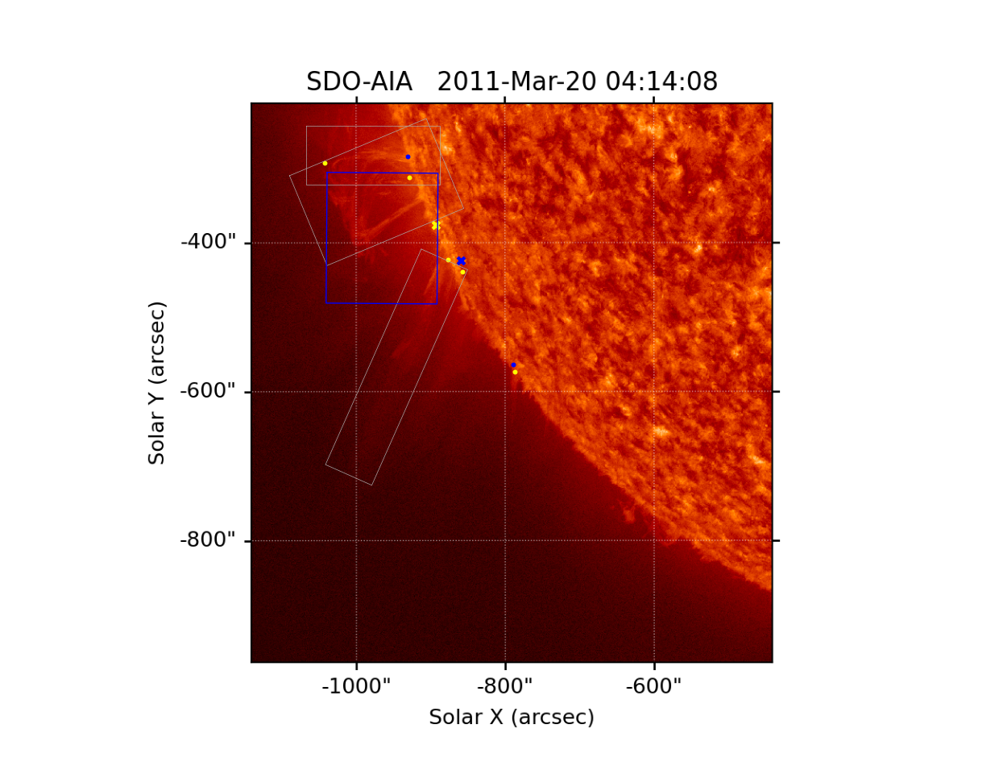

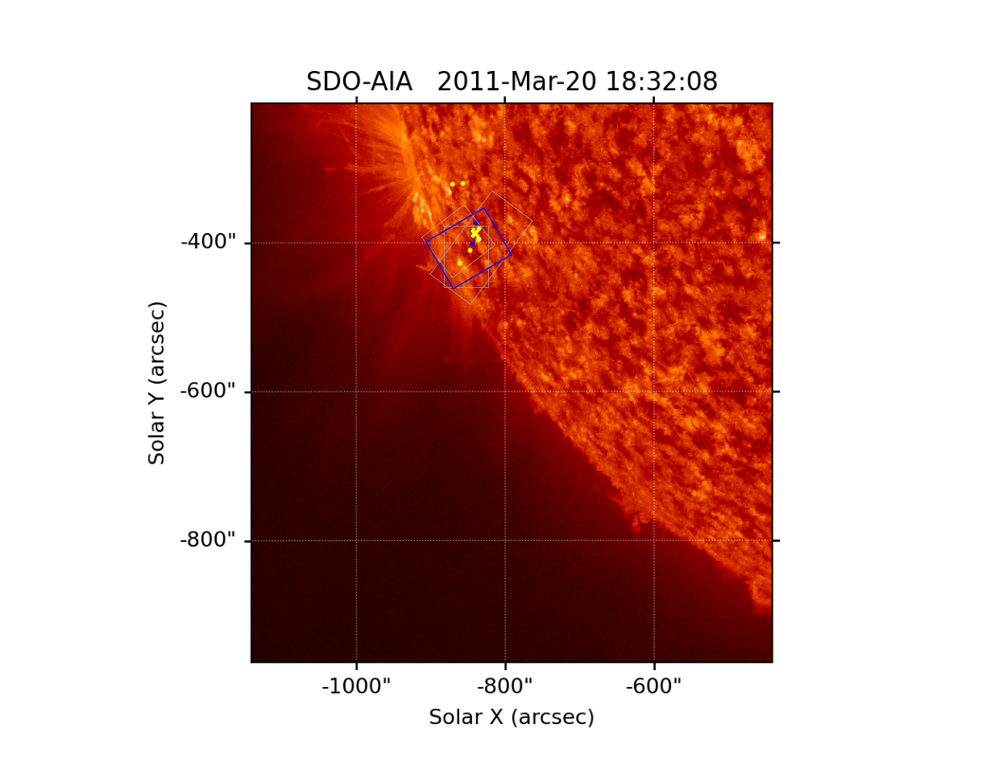

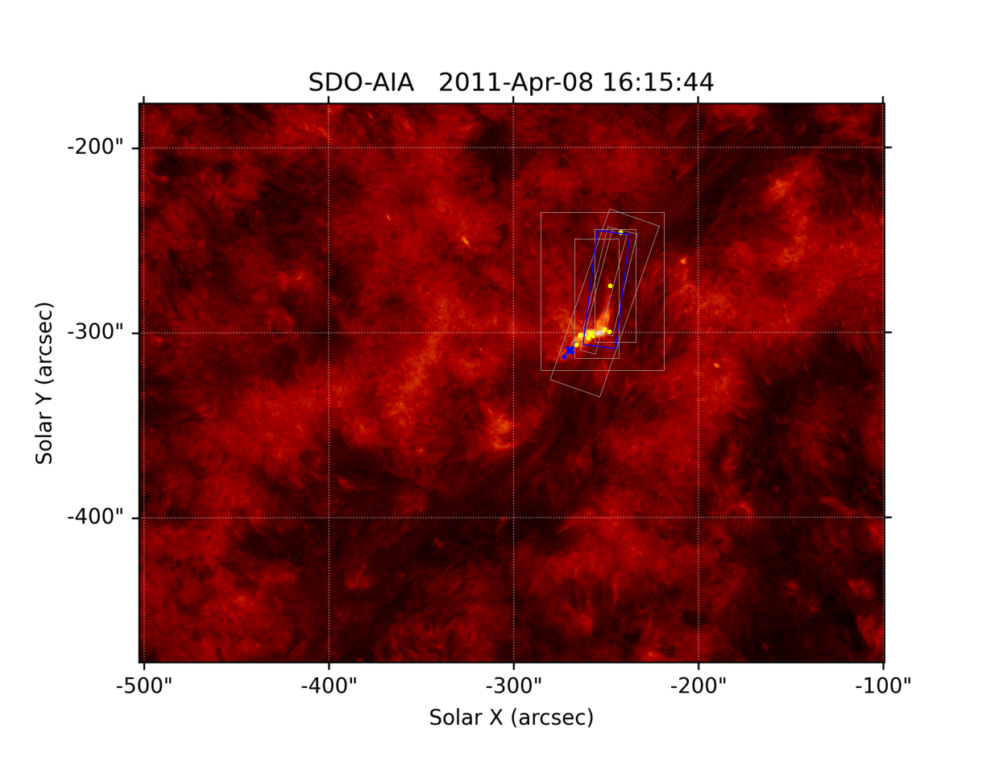

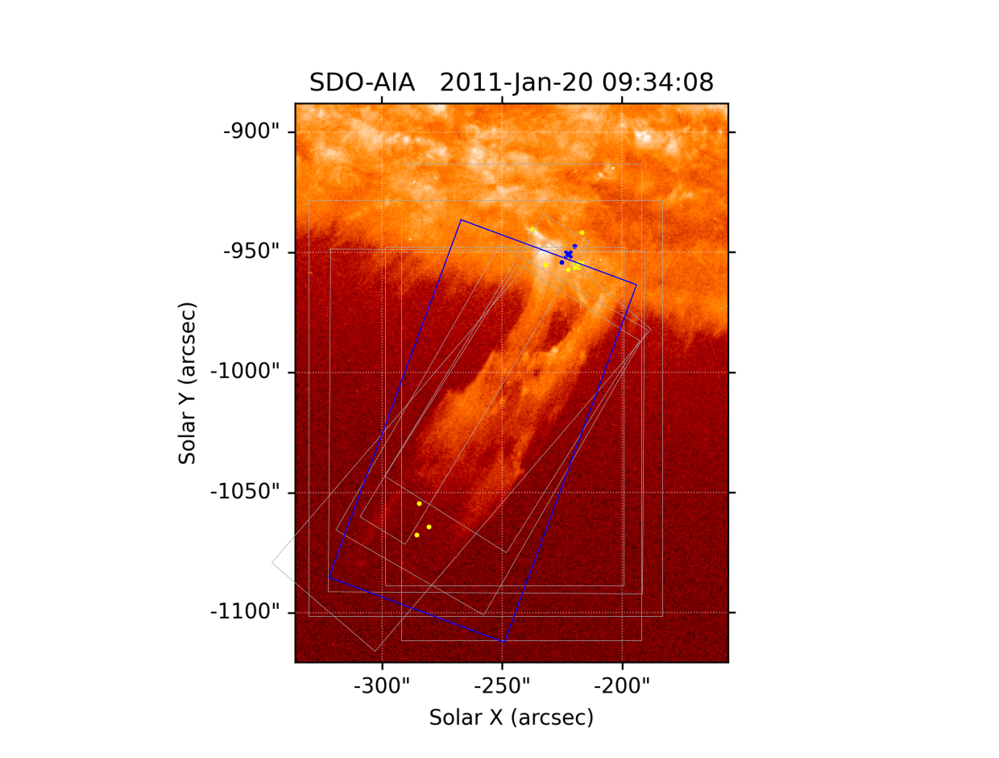

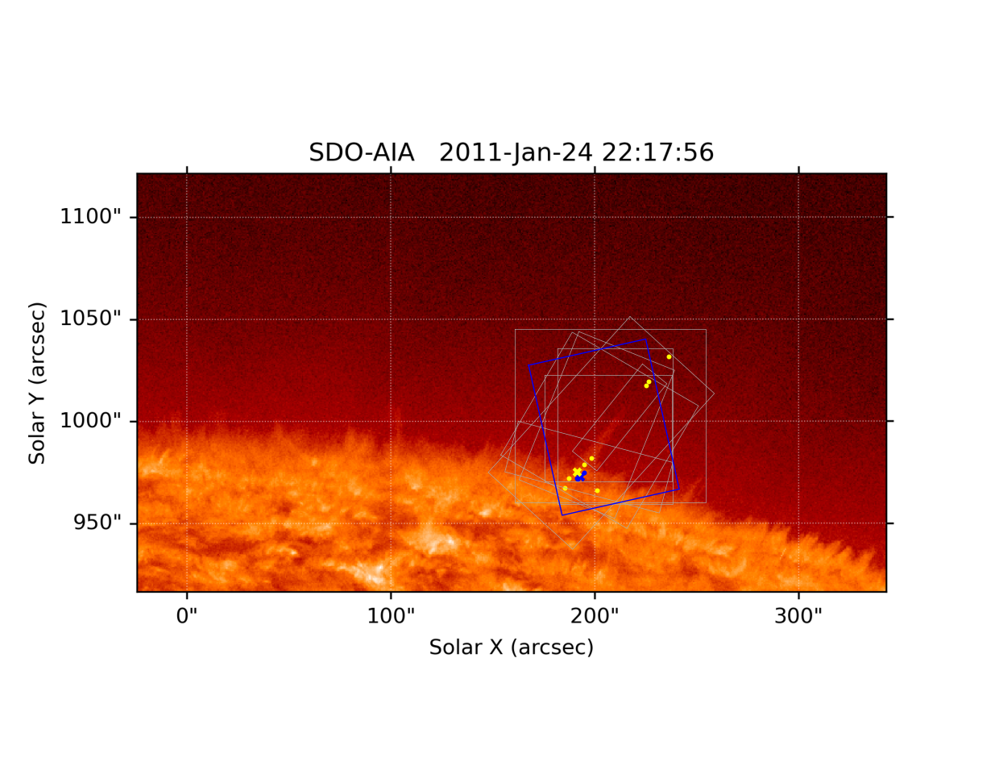

...

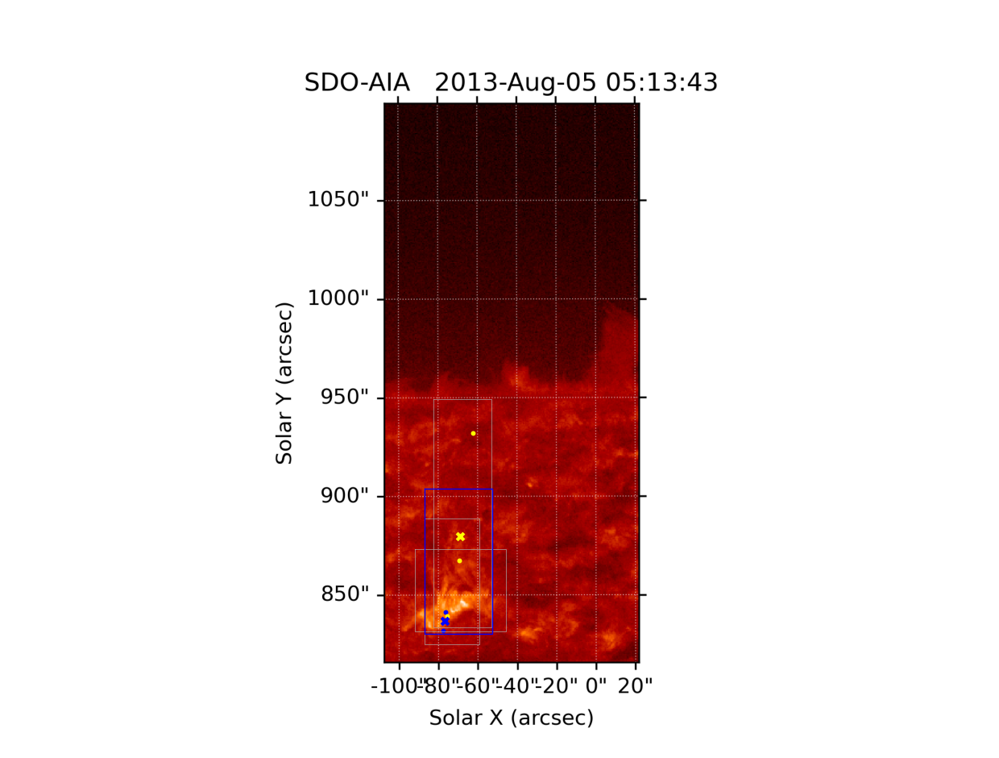

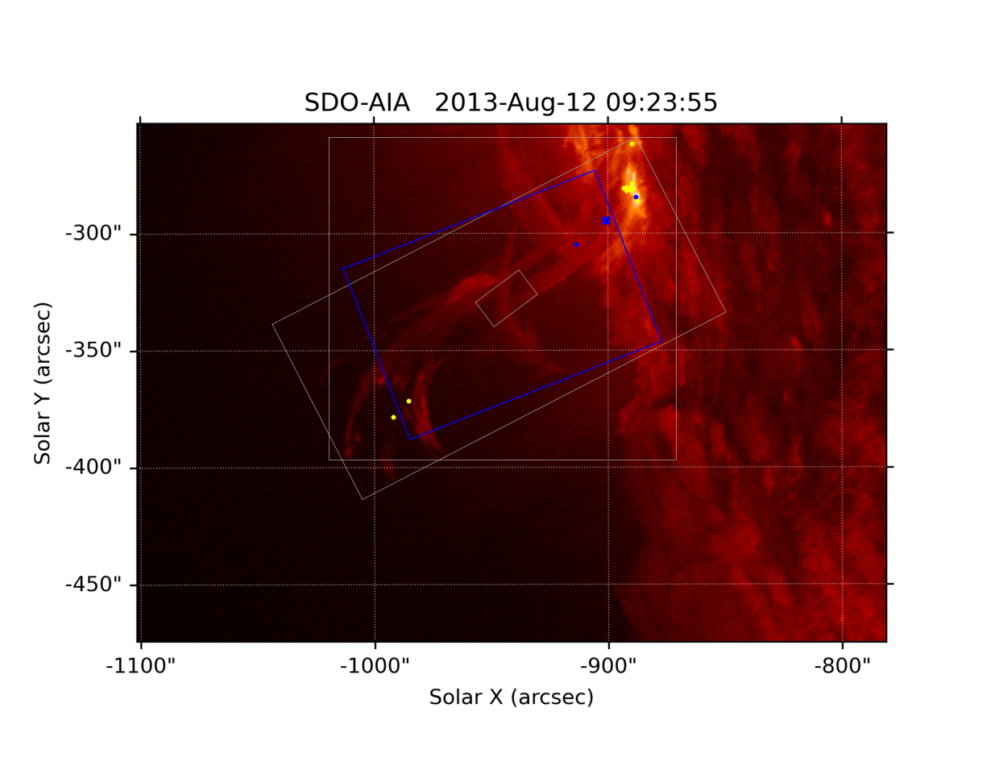

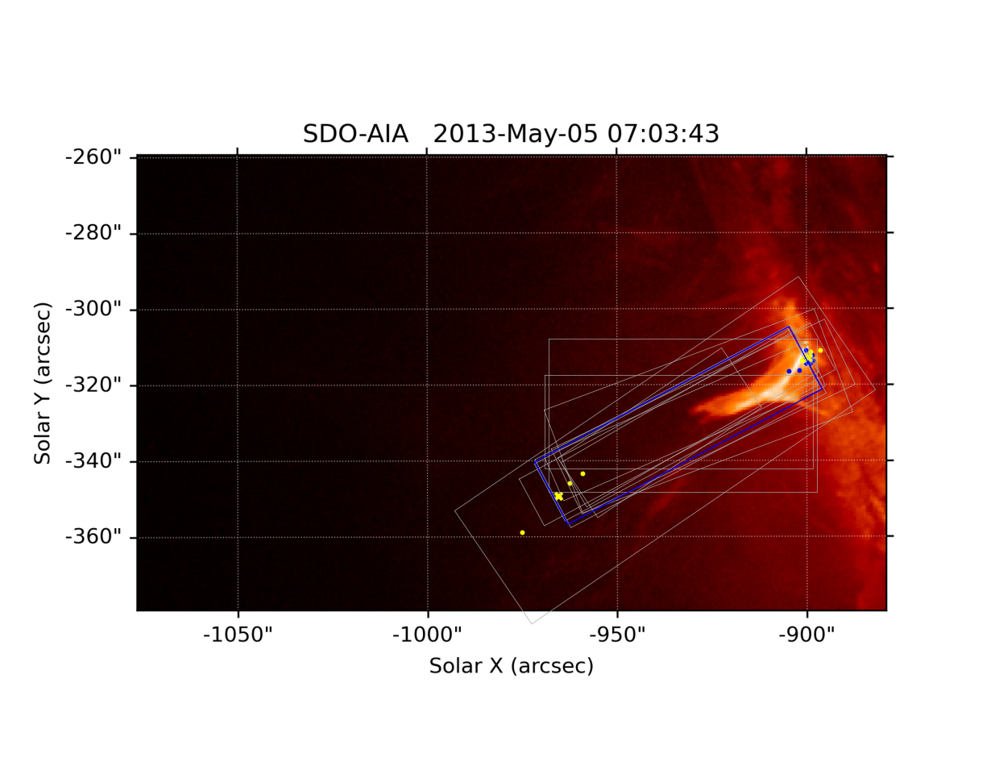

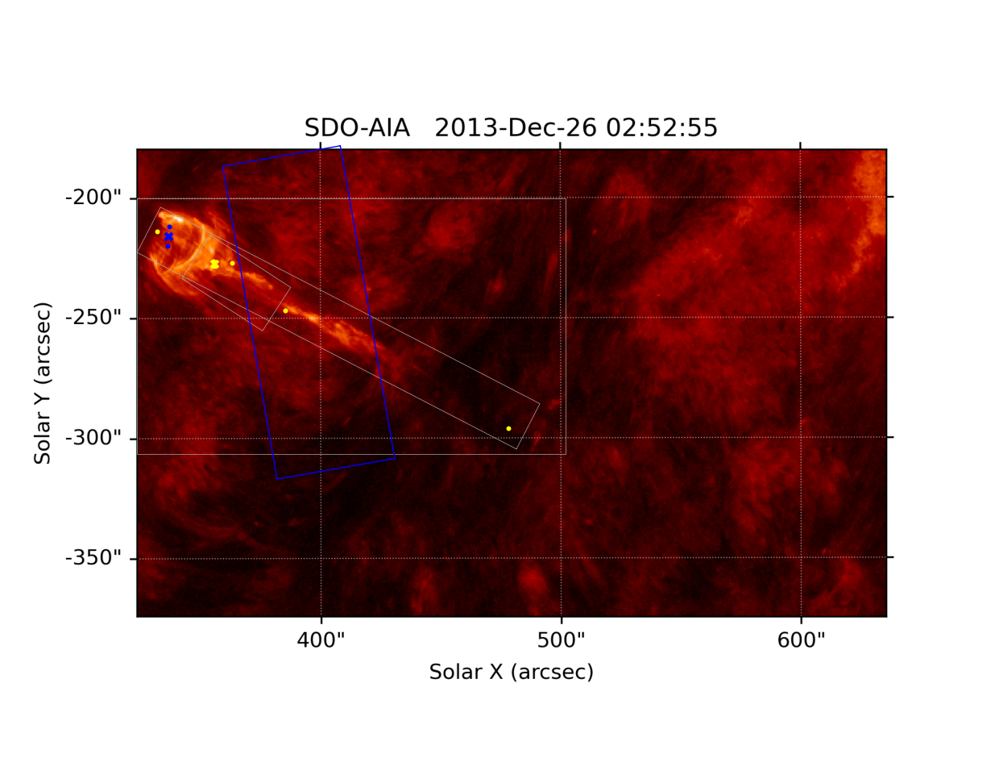

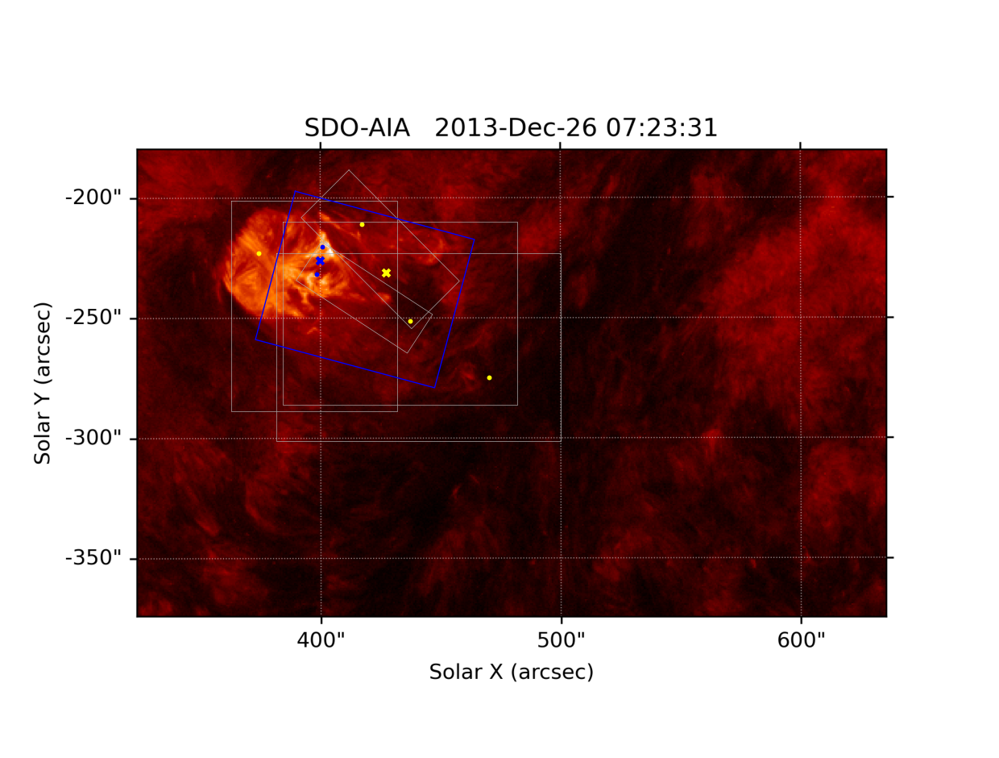

In [9]:
plt.style.use('default')

for i, subject in enumerate(clustered_subs):
    try:
        x0_i = ast.literal_eval(points0_x[i])
        y0_i = ast.literal_eval(points0_y[i])

        cx0_i = ast.literal_eval(clusters0_x[i])
        cy0_i = ast.literal_eval(clusters0_y[i])

        x1_i = ast.literal_eval(points1_x[i])
        y1_i = ast.literal_eval(points1_y[i])

        cx1_i = ast.literal_eval(clusters1_x[i])
        cy1_i = ast.literal_eval(clusters1_y[i])
    except ValueError:
        continue
    
    box_data_T1 = box_data[:][(box_data['subject_id']==subject)&(box_data['task']=='T1')]
    try:
        x_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_x'][0])
        y_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_y'][0])
        w_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_width'][0])
        h_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_height'][0])
        a_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_angle'][0])

        cx_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_x'][0])
        cy_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_y'][0])
        cw_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_width'][0])
        ch_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_height'][0])
        ca_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_angle'][0])
    except ValueError:
        continue
    
    subjecti = Subject(int(subject))
    try:
        frame0_url = subjecti.raw['locations'][7]['image/png']
    except KeyError:
        frame0_url = subjecti.raw['locations'][7]['image/jpeg']
    
    img = io.imread(frame0_url)
    
    fig, ax = plt.subplots(1, 1, dpi=200)
    ax.imshow(img)
    
    ax.scatter(x0_i, y0_i, 5.0, marker='.', color='blue')
    ax.scatter(x1_i, y1_i, 5.0, marker='.', color='yellow')
    
    ax.scatter(cx0_i, cy0_i, 10.0, marker='x', color='blue')
    ax.scatter(cx1_i, cy1_i, 10.0, marker='x', color='yellow')
    
    for j in range(len(x_i)):
        points = get_box_edges(x_i[j], y_i[j], w_i[j], h_i[j], np.radians(a_i[j]))
        ax.plot(points[:,0], points[:,1], '-', linewidth=0.25, color='#aaa')
        
    for j in range(len(cx_i)):
        clust = get_box_edges(cx_i[j], cy_i[j], cw_i[j], ch_i[j], np.radians(ca_i[j]))
        ax.plot(clust[:,0], clust[:,1], '-', linewidth=0.5, color='blue')
    
    
    ax.axis('off')
    fig.tight_layout()
    plt.show()

Extra code for Daily Zoo

In [7]:
subs = [70439523, 70444870, 62835854, 70440429, 70443011, 70439372, 62833271, 62833555, 62835317]

data.frame0.T5_tool0_points_x ... data.frame0.T1_tool0_clusters_var_x_y
----------------------------- ... -------------------------------------
                           -- ...                  [-410.5084600187838]


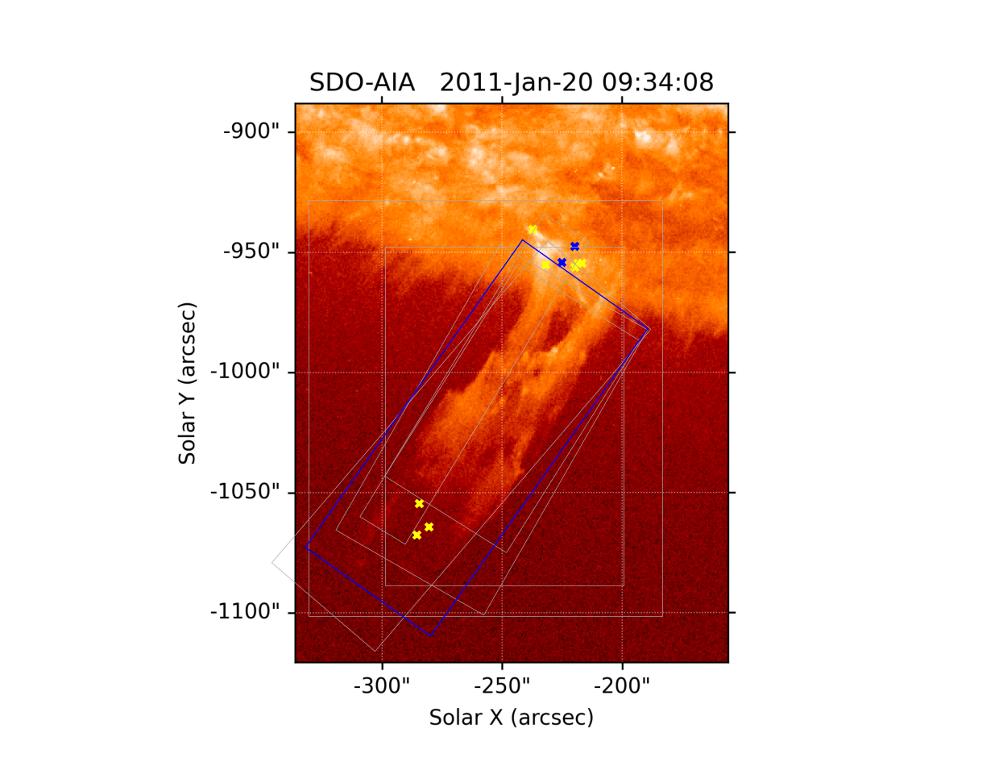

data.frame0.T5_tool0_points_x ... data.frame0.T1_tool0_clusters_var_x_y
----------------------------- ... -------------------------------------
                           -- ...                                    --
data.frame0.T5_tool0_points_x ... data.frame0.T1_tool0_clusters_var_x_y
----------------------------- ... -------------------------------------
data.frame0.T5_tool0_points_x ... data.frame0.T1_tool0_clusters_var_x_y
----------------------------- ... -------------------------------------
                           -- ...                                    --
data.frame0.T5_tool0_points_x ... data.frame0.T1_tool0_clusters_var_x_y
----------------------------- ... -------------------------------------
                           -- ...                                    --
data.frame0.T5_tool0_points_x ... data.frame0.T1_tool0_clusters_var_x_y
----------------------------- ... -------------------------------------
                           -- ...                               

In [24]:
plt.style.use('default')

for i, subject in enumerate(subs):
    points_data_T1 = points_data[:][(points_data['subject_id']==subject)&(points_data['task']=='T1')]
    try:
        print(points_data_T1[[coli for coli in points_data_T1.colnames if 'tool0' in coli]])
        x0_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool0_points_x'][0])
        y0_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool0_points_y'][0])
        
        cx0_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool0_points_x'][0])
        cy0_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool0_points_y'][0])
        
        x1_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool1_points_x'][0])
        y1_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool1_points_y'][0])
        
        cx1_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool1_points_x'][0])
        cy1_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool1_points_y'][0])
    except ValueError:
        continue
    except IndexError:
        continue
    
    box_data_T1 = box_data[:][(box_data['subject_id']==subject)&(box_data['task']=='T1')]
    try:
        x_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_x'][0])
        y_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_y'][0])
        w_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_width'][0])
        h_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_height'][0])
        a_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_rotateRectangle_angle'][0])

        cx_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_x'][0])
        cy_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_y'][0])
        cw_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_width'][0])
        ch_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_height'][0])
        ca_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_angle'][0])
    except ValueError:
        continue
    
    subjecti = Subject(int(subject))
    try:
        frame_urls = [subjecti.raw['locations'][j]['image/png'] for j in range(15)]
    except KeyError:
        frame_urls = [subjecti.raw['locations'][j]['image/jpeg'] for j in range(15)]
    
    img = io.imread(frame_urls[0])
    
    fig, ax = plt.subplots(1, 1, dpi=200)
    ax.imshow(img)
    
    ax.scatter(x0_i, y0_i, 5.0, marker='.', color='blue')
    ax.scatter(x1_i, y1_i, 5.0, marker='.', color='yellow')
    
    ax.scatter(cx0_i, cy0_i, 10.0, marker='x', color='blue')
    ax.scatter(cx1_i, cy1_i, 10.0, marker='x', color='yellow')
    
    for j in range(len(x_i)):
        points = get_box_edges(x_i[j], y_i[j], w_i[j], h_i[j], np.radians(a_i[j]))
        ax.plot(points[:,0], points[:,1], '-', linewidth=0.25, color='#aaa')
        
    for j in range(len(cx_i)):
        clust = get_box_edges(cx_i[j], cy_i[j], cw_i[j], ch_i[j], np.radians(ca_i[j]))
        ax.plot(clust[:,0], clust[:,1], '-', linewidth=0.5, color='blue')
    
    
    ax.axis('off')
    fig.tight_layout()
    plt.show()

In [9]:
extract_points_file = 'point_extractor_by_frame_test.csv'
extract_points_data = ascii.read(extract_points_file, delimiter=',')
extract_box_file = 'shape_extractor_rotateRectangle_test.csv'
extract_box_data = ascii.read(extract_box_file, delimiter=',')

extract_points_data.fill_value = 'None'
extract_box_data.fill_value = 'None'

extract_points_data = extract_points_data.filled()
extract_box_data = extract_box_data.filled()

70439523
data.frame0.T5_tool0_points_x ... data.frame0.T1_tool0_clusters_var_x_y
----------------------------- ... -------------------------------------
                           -- ...                  [-410.5084600187838]
[]
[]
[]
[]
[]
[]
[]
[]
[822.4414935384602]
[792.4682351646095]
[875.5709838867188]
[]
[]
[]
[579.9140625, 774.6437377929688, 748.743408008453, 732.422119140625, 857.1322966711527, 736.2235977469277, 764.530517578125, 621.8825988769531]
[[[986.47509765625, 1127.645263671875, 1091.01318359375, 1020.8401489257812, 1094.2655029296875, 1048.8236083984375, 1071.4381103515625, 1120.058349609375, 1085.5089111328125], [744.5216674804688, 488.8971252441406, 473.77490234375, 424.5843505859375, 470.1872253417969, 467.93023681640625, 498.1474609375, 501.9665222167969, 483.65899658203125]], [[], []], [[], []], [[], []], [[], []], [[], []], [[], []], [[], []], [[], []], [[], []], [[], []], [[], []], [[], []], [[], []], [[1108.44140625, 1082.0616455078125], [456.291259765625, 487

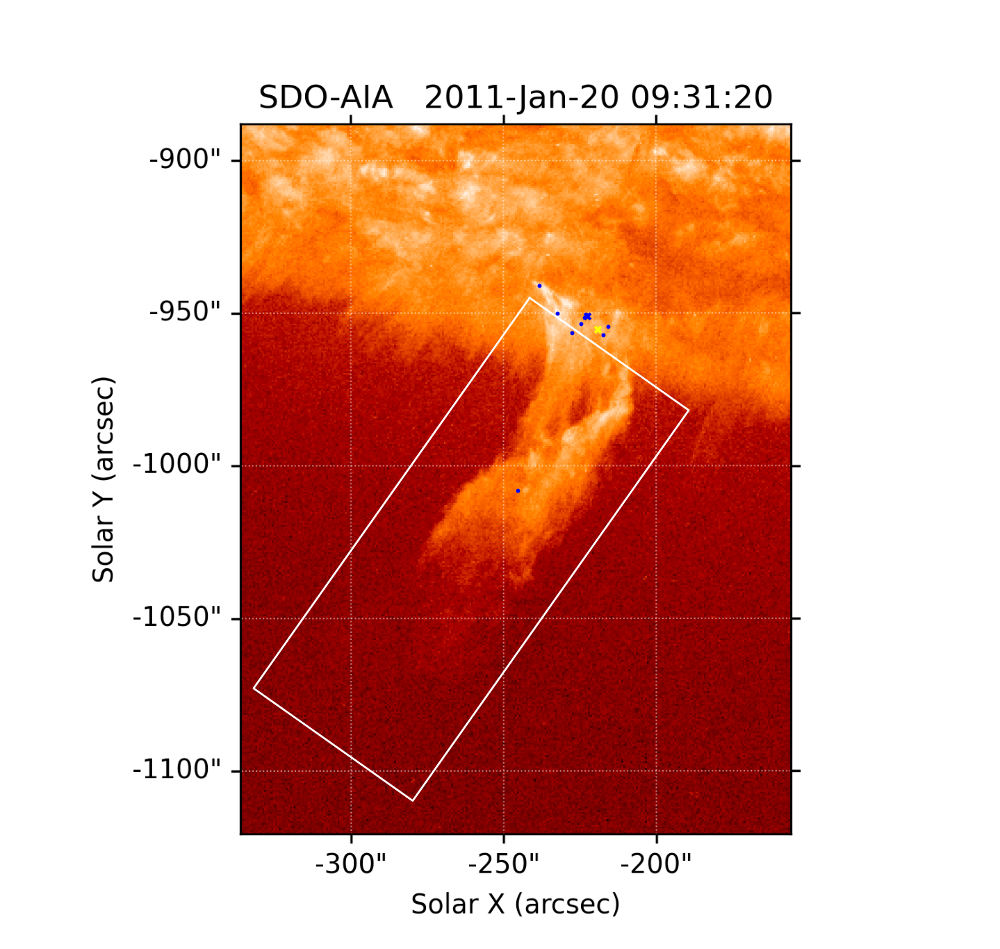

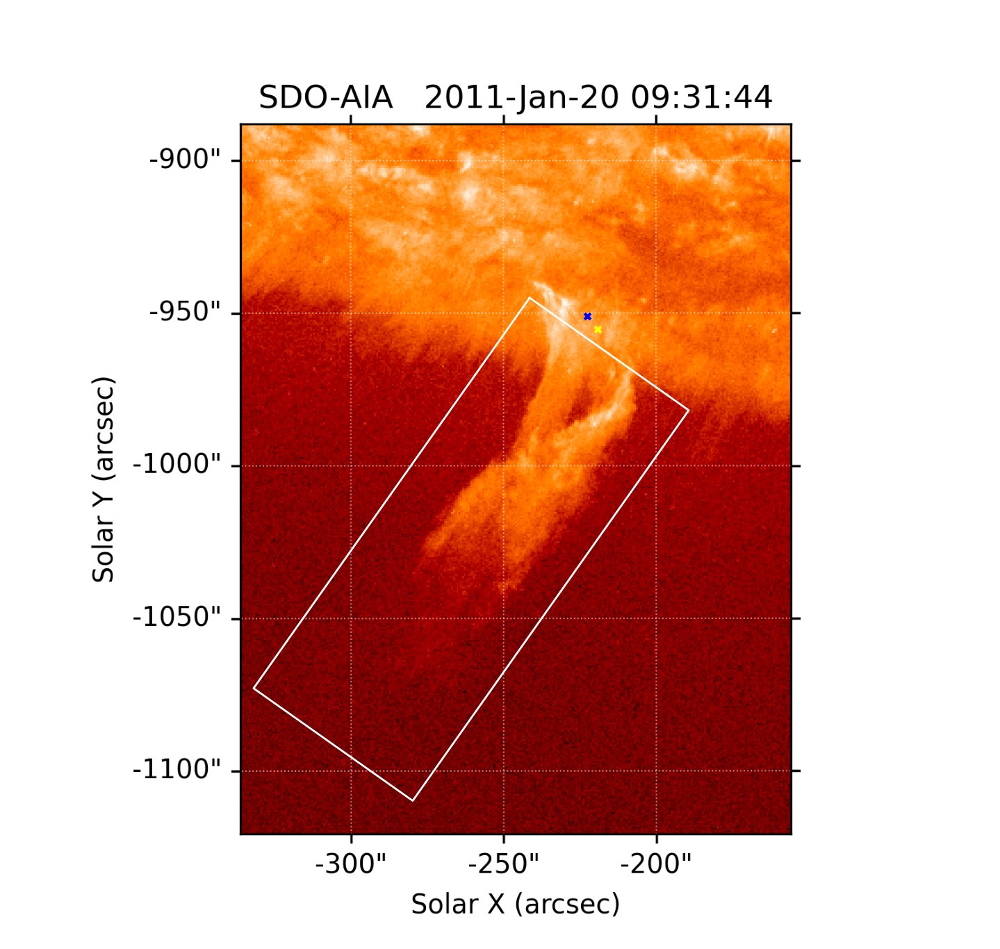

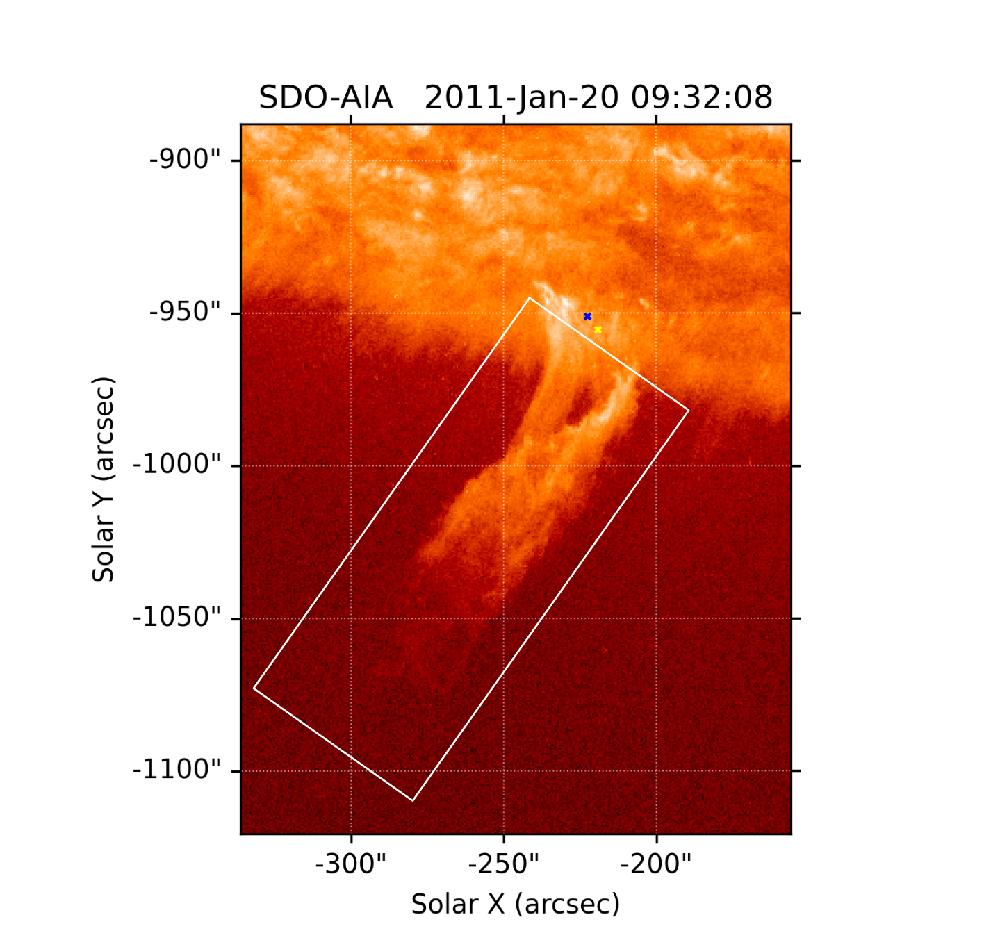

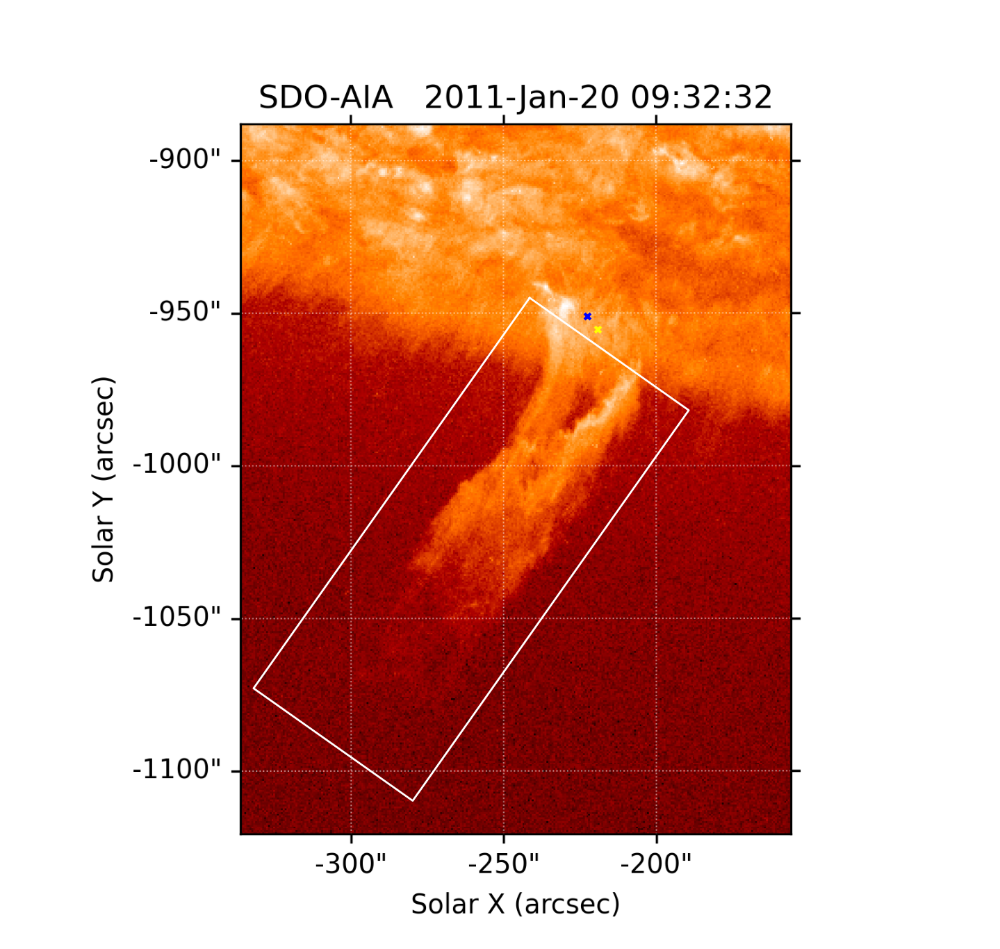

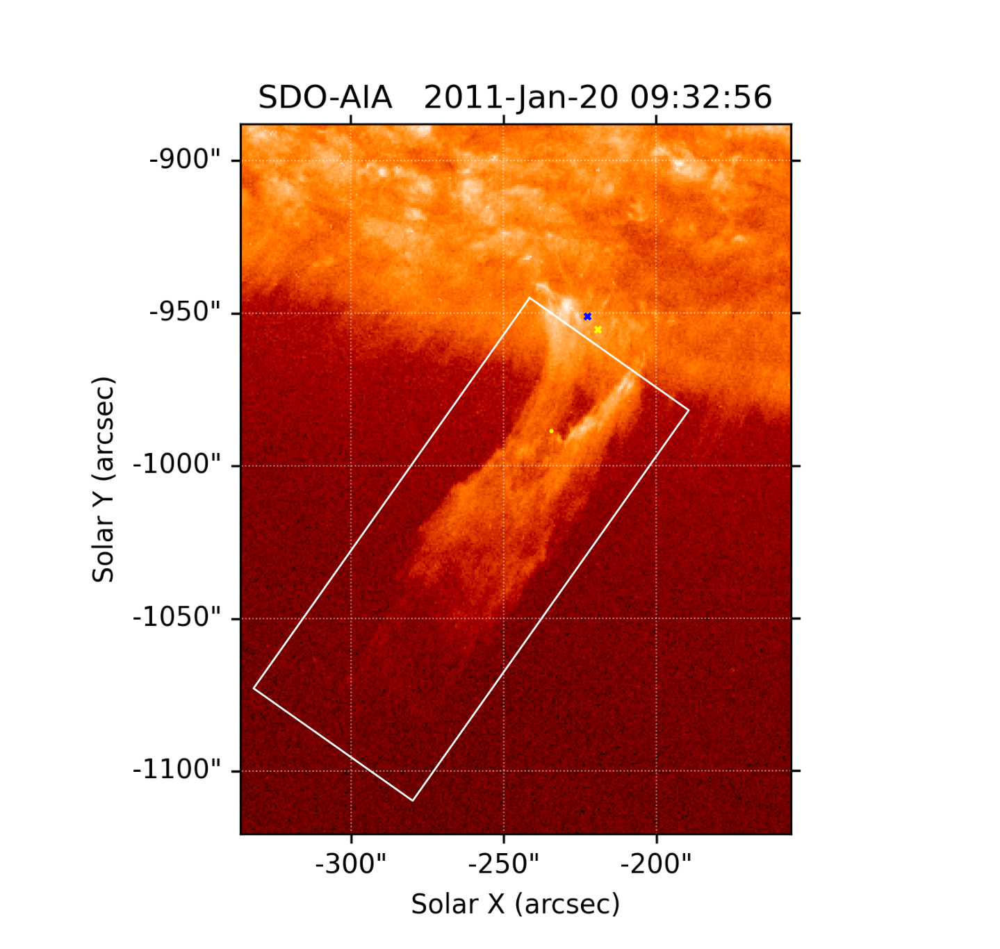

...

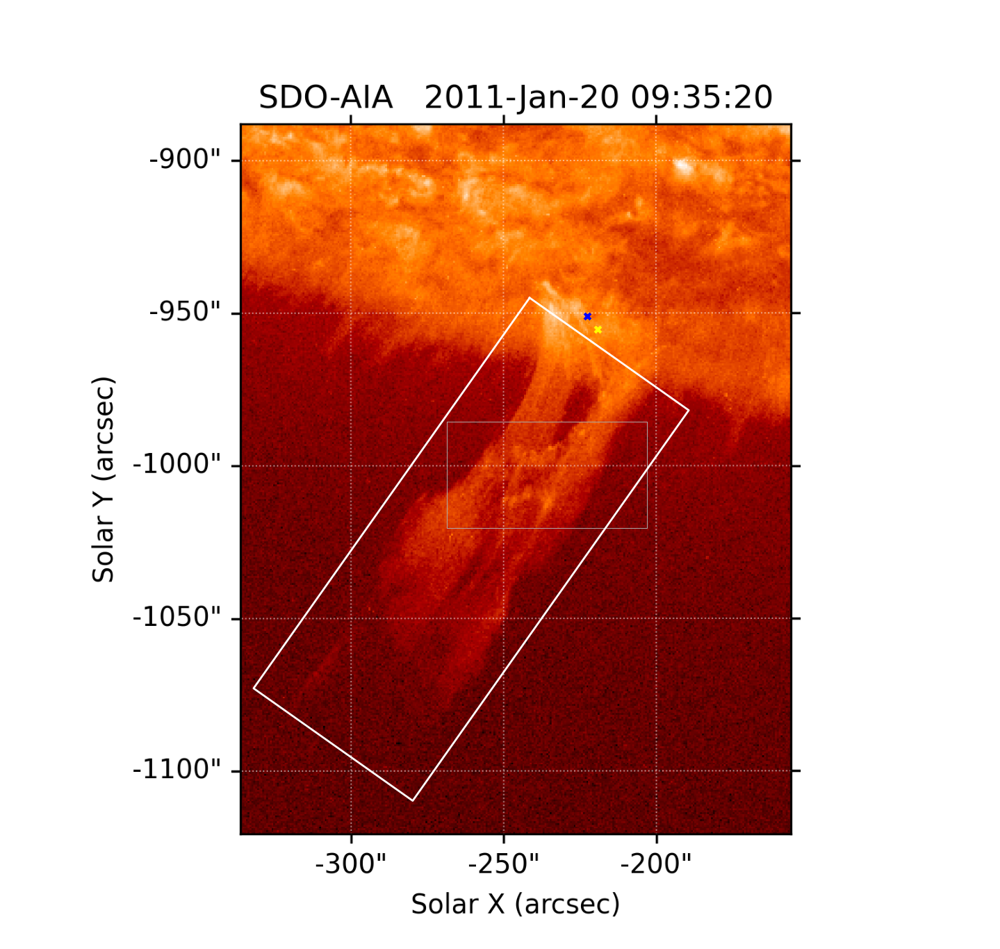

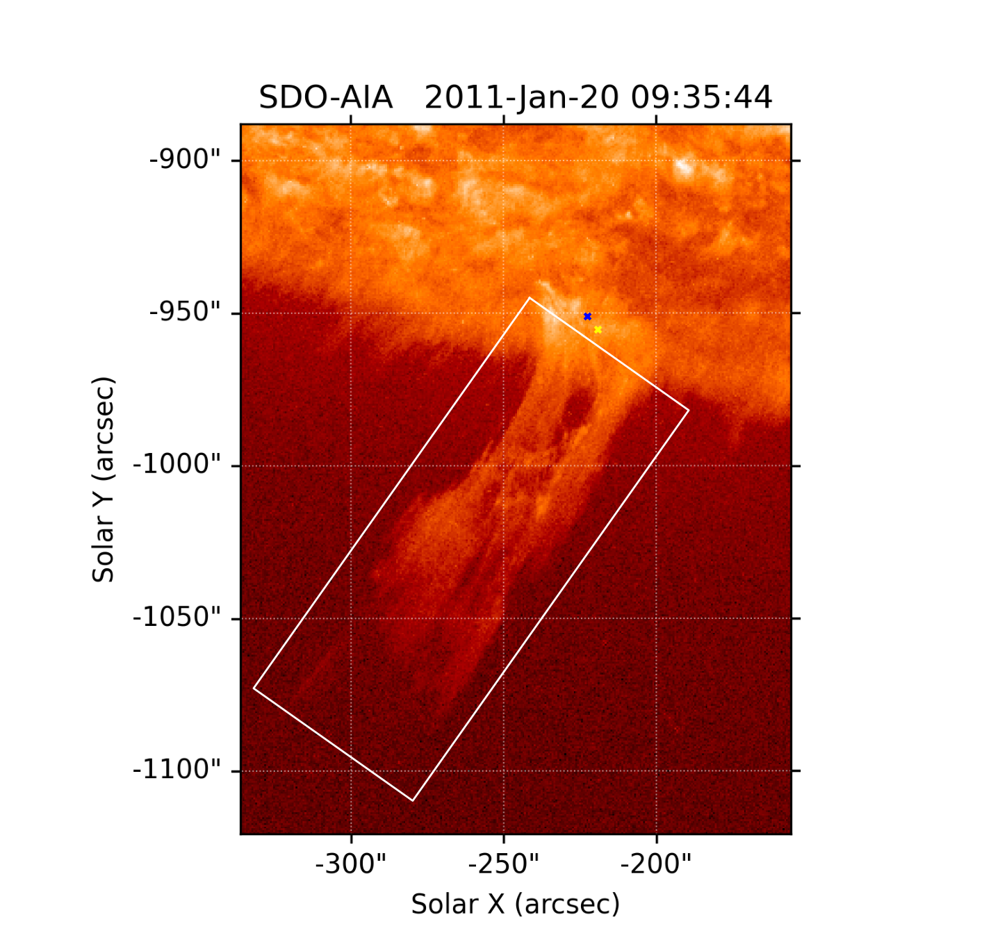

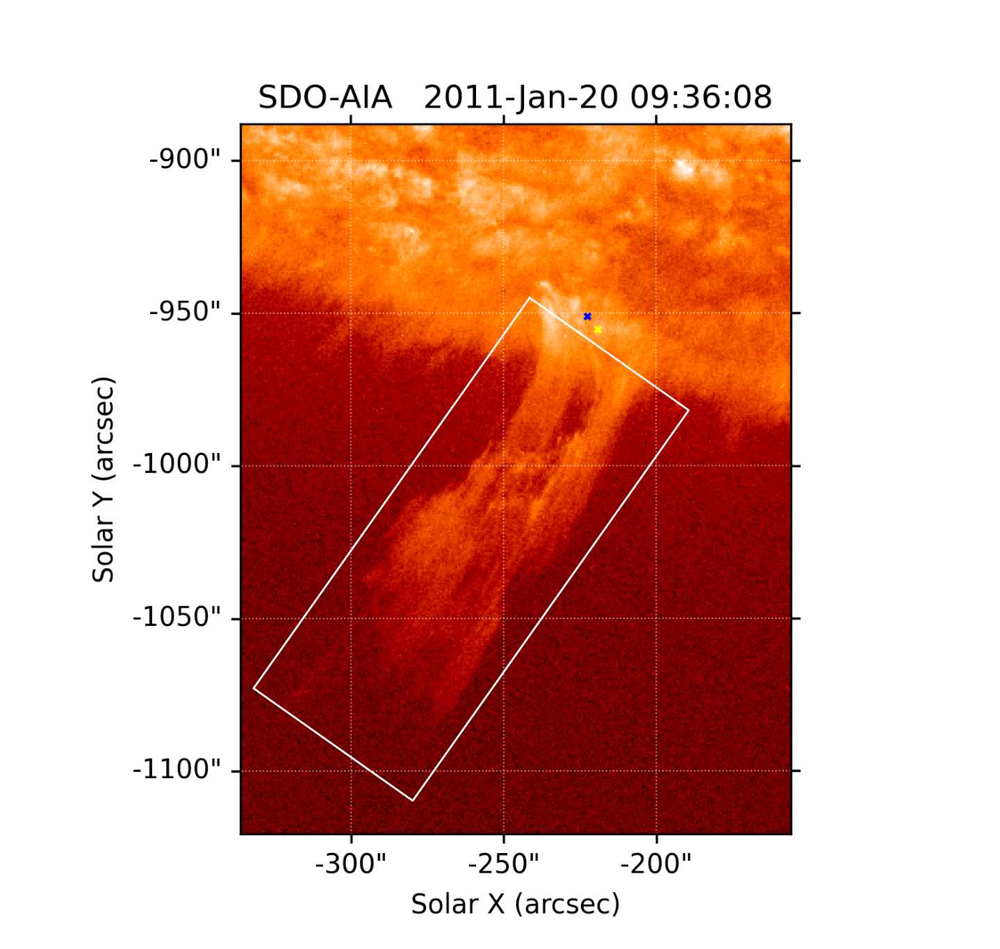

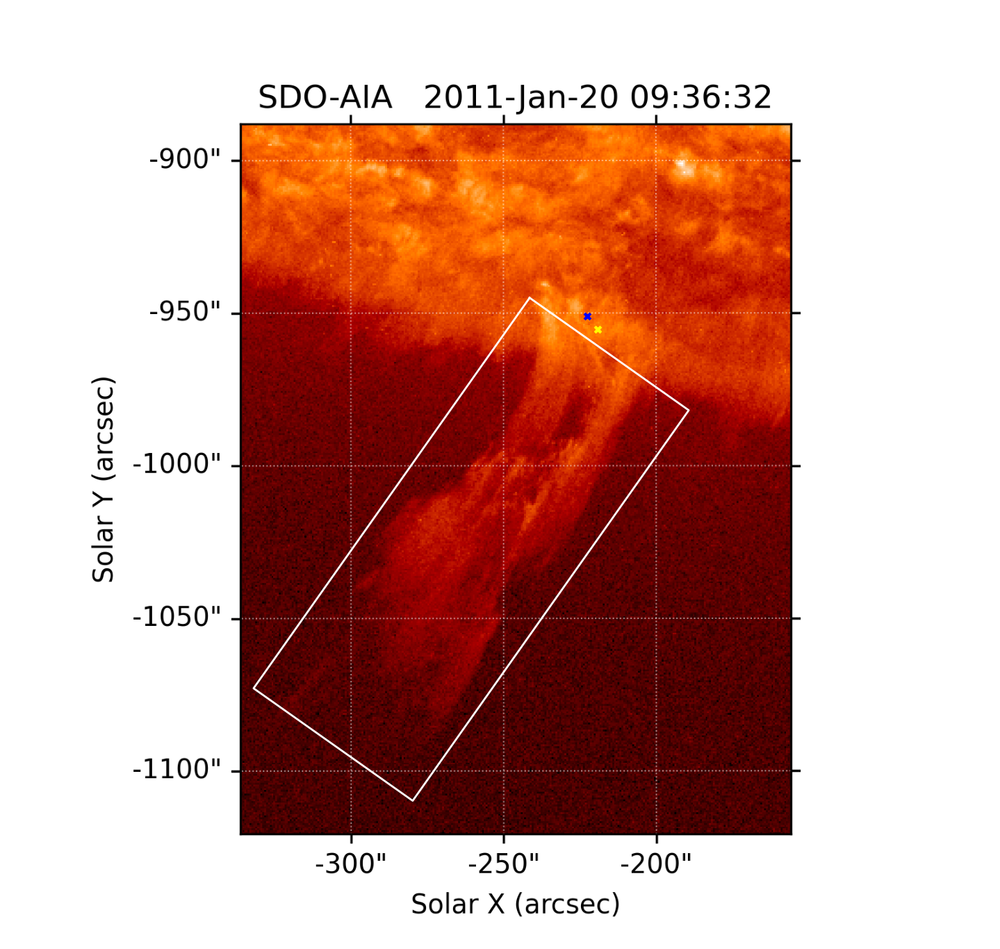

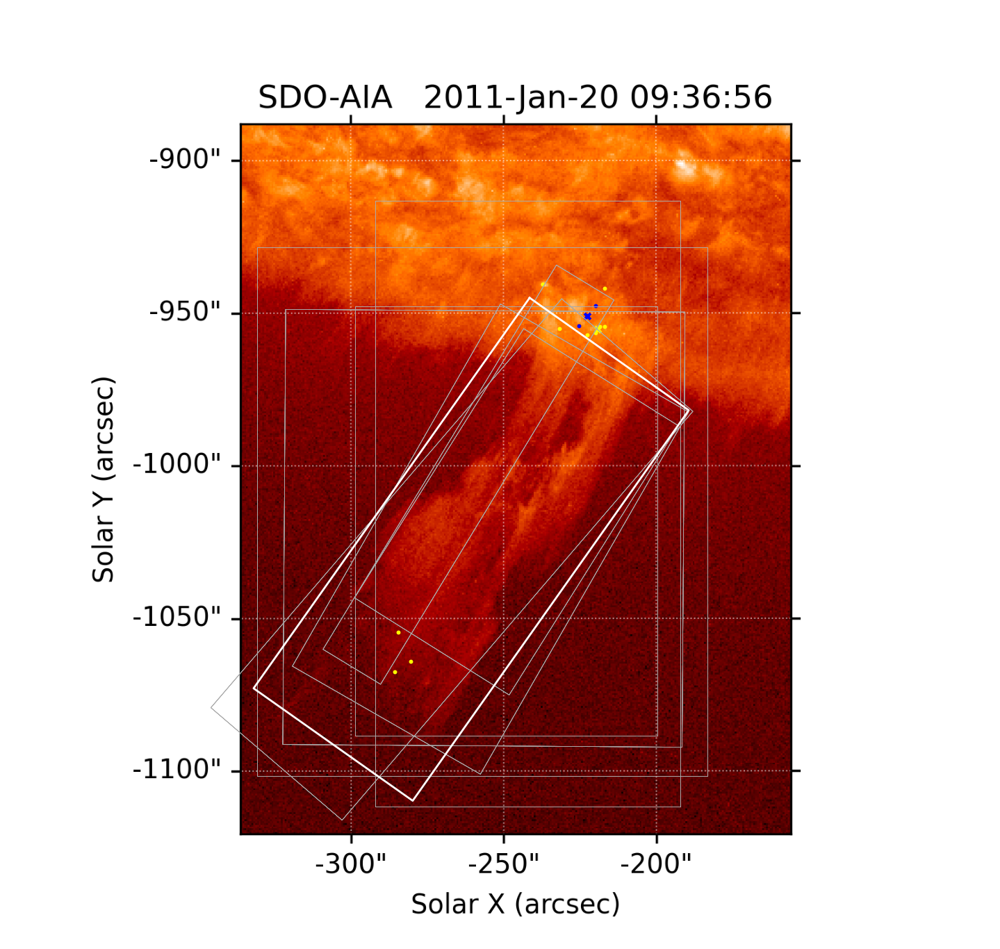

In [28]:
plt.style.use('default')

for i, subject in enumerate(subs):
    print(subject)
    points_data_T1 = points_data[:][(points_data['subject_id']==subject)&(points_data['task']=='T1')]
    box_data_T1 = box_data[:][(box_data['subject_id']==subject)&(box_data['task']=='T1')]
    
    ext_points_data_T1 = extract_points_data[:][(extract_points_data['subject_id']==subject)&(extract_points_data['task']=='T1')]
    ext_box_data_T1 = extract_box_data[:][(extract_box_data['subject_id']==subject)&(extract_box_data['task']=='T1')]
    
    
    try:
        print(points_data_T1[[coli for coli in points_data_T1.colnames if 'tool0' in coli]])
        cx0_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool0_clusters_x'][0])
        cy0_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool0_clusters_y'][0])
        
        cx1_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool1_clusters_x'][0])
        cy1_i = ast.literal_eval(points_data_T1['data.frame0.T1_tool1_clusters_y'][0])
        
        cx_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_x'][0])
        cy_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_y'][0])
        cw_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_width'][0])
        ch_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_height'][0])
        ca_i = ast.literal_eval(box_data_T1['data.frame0.T1_tool2_clusters_angle'][0])
    except ValueError:
        continue
    except IndexError:
        continue
        
    starts = []
    ends   = []
    boxes  = []
#     ### Get the extracts by frame number
    for j in range(15):
        try:
            x0_data = ext_points_data_T1[f'data.frame{j}.T1_tool0_x'][ext_points_data_T1[f'data.frame{j}.T1_tool0_x']!='N/A']
            y0_data = ext_points_data_T1[f'data.frame{j}.T1_tool0_y'][ext_points_data_T1[f'data.frame{j}.T1_tool0_y']!='N/A']
        
            x0_j = [ast.literal_eval(di)[0] for di in x0_data]
            y0_j = [ast.literal_eval(di)[0] for di in y0_data]
            starts.append([x0_j, y0_j])
        except ValueError:
            starts.append([])
        
        try:
            x1_data = ext_points_data_T1[f'data.frame{j}.T1_tool1_x'][ext_points_data_T1[f'data.frame{j}.T1_tool1_x']!='N/A']
            y1_data = ext_points_data_T1[f'data.frame{j}.T1_tool1_y'][ext_points_data_T1[f'data.frame{j}.T1_tool1_y']!='N/A']
            x1_j = [ast.literal_eval(di)[0] for di in x1_data]
            y1_j = [ast.literal_eval(di)[0] for di in y1_data]
            ends.append([x1_j, y1_j])
        except ValueError:
            ends.append([])
            
        try:
            maski = ext_box_data_T1[f'data.frame{j}.T1_tool2_x']!='N/A'
            x_data = ext_box_data_T1[f'data.frame{j}.T1_tool2_x'][maski]
            y_data = ext_box_data_T1[f'data.frame{j}.T1_tool2_y'][maski]
            w_data = ext_box_data_T1[f'data.frame{j}.T1_tool2_width'][maski]
            h_data = ext_box_data_T1[f'data.frame{j}.T1_tool2_height'][maski]
            a_data = ext_box_data_T1[f'data.frame{j}.T1_tool2_angle'][maski]
        
            x_j = [ast.literal_eval(di)[0] for di in x_data]
            y_j = [ast.literal_eval(di)[0] for di in y_data]
            w_j = [ast.literal_eval(di)[0] for di in w_data]
            h_j = [ast.literal_eval(di)[0] for di in h_data]
            a_j = [ast.literal_eval(di)[0] for di in a_data]
            
            print(x_j)
        
            boxes.append([x_j, y_j, w_j, h_j, a_j])
        except ValueError:
            boxes.append([])
    print(starts)
    subjecti = Subject(int(subject))
    try:
        frame_urls = [subjecti.raw['locations'][j]['image/png'] for j in range(15)]
    except KeyError:
        frame_urls = [subjecti.raw['locations'][j]['image/jpeg'] for j in range(15)]
    
    for j in range(15):
        img = io.imread(frame_urls[j])
        print(frame_urls[j])

        crop = 200
        
        fig, ax = plt.subplots(1, 1, figsize=(7, 10), dpi=200)
        ax.imshow(img[:,crop:-crop])
        print(img.shape)

    #     ax.scatter(x0_i, y0_i, 5.0, marker='.', color='blue')
    #     ax.scatter(x1_i, y1_i, 5.0, marker='.', color='yellow')

        ax.scatter(np.asarray(cx0_i)-crop, cy0_i, 10.0, marker='x', color='blue')
        ax.scatter(np.asarray(cx1_i)-crop, cy1_i, 10.0, marker='x', color='yellow')

        for k in range(len(boxes[j])):
            if len(boxes[j][0]) > 0:
                boxj = boxes[j]
                for kk in range(len(boxes[j][0])):
                    points = get_box_edges(boxj[0][kk]-crop, boxj[1][kk], boxj[2][kk], boxj[3][kk], np.radians(boxj[4][kk]))
                    ax.plot(points[:,0], points[:,1], '-', linewidth=0.25, color='#aaa')

        ax.scatter(np.asarray(starts[j][0])-crop, starts[j][1], 5.0, marker='.', color='blue')
        ax.scatter(np.asarray(ends[j][0])-crop, ends[j][1], 5.0, marker='.', color='yellow')

        for k in range(len(cx_i)):
            clust = get_box_edges(cx_i[k], cy_i[k], cw_i[k], ch_i[k], np.radians(ca_i[k]))
            ax.plot(np.asarray(clust[:,0])-crop, clust[:,1], '-', linewidth=1.0, color='white')


        ax.axis('off')
        plt.subplots_adjust(top=1, left=0, right=1, bottom=0)
        plt.savefig(f'{subject}_frame{j}.png', bbox_inches='tight')
    